<a href="https://colab.research.google.com/github/sthalles/face-similarity/blob/master/inference.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Face-similarity
Face-similarity CNN using Tensorflow Eager execution.

Medium article: [How to train your own FaceID ConvNet using TensorFlow Eager execution](https://medium.freecodecamp.org/how-to-train-your-own-faceid-cnn-using-tensorflow-eager-execution-6905afe4fd5a)

This implementation uses DenseNets with contrastive loss.

Reference Papers: 
- [Densely Connected Convolutional Networks](https://arxiv.org/abs/1608.06993)
- [Dimensionality Reduction by Learning an Invariant Mapping](https://ieeexplore.ieee.org/document/1640964)

In [1]:
import tensorflow as tf

print(tf.__version__)
tf.enable_eager_execution()

Instructions for updating:
The TensorFlow Distributions library has moved to TensorFlow Probability (https://github.com/tensorflow/probability). You should update all references to use `tfp.distributions` instead of `tf.distributions`.
Instructions for updating:
The TensorFlow Distributions library has moved to TensorFlow Probability (https://github.com/tensorflow/probability). You should update all references to use `tfp.distributions` instead of `tf.distributions`.
1.12.0


### Running locally

1- Download the pre-trained model using the following link.
  * Place the `tboard_logs` folder in the root folder of the project.
  
- [Tensorflow pre-trained model](https://www.dropbox.com/sh/qgz0gw6pqkn64gq/AAAi4eQ97f2yNo8wRQ4FEx-3a?dl=0)

2- Download the following test dataset (TfRecords format).
  * Place the `dataset` folder in the root folder of the project.

- [Download test dataset](https://www.dropbox.com/sh/qgz0gw6pqkn64gq/AAAi4eQ97f2yNo8wRQ4FEx-3a?dl=0)

3- Run the jupyter notebook `inference.ipynb`
  * Run the notebook. Adjust the dataset paths accordingly. 
  

In [2]:
# if running locally, comment these lines
!wget https://www.dropbox.com/s/4tjix8rhyzxpc28/dataset.tar.gz
!wget https://www.dropbox.com/s/zj1v8n5href2mtu/tboard_logs.tar.gz
!tar -xvzf dataset.tar.gz
!tar -xvzf tboard_logs.tar.gz

--2019-05-26 17:22:20--  https://www.dropbox.com/s/4tjix8rhyzxpc28/dataset.tar.gz
Resolving www.dropbox.com (www.dropbox.com)... 2620:100:6030:1::a27d:5001, 162.125.80.1
Connecting to www.dropbox.com (www.dropbox.com)|2620:100:6030:1::a27d:5001|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: /s/raw/4tjix8rhyzxpc28/dataset.tar.gz [following]
--2019-05-26 17:22:21--  https://www.dropbox.com/s/raw/4tjix8rhyzxpc28/dataset.tar.gz
Reusing existing connection to [www.dropbox.com]:443.
HTTP request sent, awaiting response... 302 Found
Location: https://ucdfcf4f71693de177ad2cf7100f.dl.dropboxusercontent.com/cd/0/inline/AhrnJUexhHWmrrqi35kl72v7K7RDdES4vX78pxxrzLc_BdDR0XglV1R0tfNR1xFyrz-3oS4H0YfCJbL4rMyasT0KL8PtCO6ad9pij8deX6Bmfw/file# [following]
--2019-05-26 17:22:21--  https://ucdfcf4f71693de177ad2cf7100f.dl.dropboxusercontent.com/cd/0/inline/AhrnJUexhHWmrrqi35kl72v7K7RDdES4vX78pxxrzLc_BdDR0XglV1R0tfNR1xFyrz-3oS4H0YfCJbL4rMyasT0KL8PtCO6ad9pij8deX6Bmfw

In [3]:
# if running locally, comment these lines
!mkdir src
!wget https://raw.githubusercontent.com/sthalles/face-similarity/master/src/contrastive.py
!wget https://raw.githubusercontent.com/sthalles/face-similarity/master/src/cyclical_lr.py
!wget https://raw.githubusercontent.com/sthalles/face-similarity/master/src/pre_processing.py
!wget https://raw.githubusercontent.com/sthalles/face-similarity/master/src/utils.py
!mv contrastive.py ./src/
!mv cyclical_lr.py ./src/
!mv pre_processing.py ./src/
!mv utils.py ./src/

mkdir: cannot create directory ‘src’: File exists
--2019-05-26 17:22:30--  https://raw.githubusercontent.com/sthalles/face-similarity/master/src/contrastive.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.108.133
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|151.101.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 310 [text/plain]
Saving to: ‘contrastive.py’

contrastive.py      100%[===================>]     310  --.-KB/s    in 0s      

2019-05-26 17:22:31 (17.7 MB/s) - ‘contrastive.py’ saved [310/310]

--2019-05-26 17:22:31--  https://raw.githubusercontent.com/sthalles/face-similarity/master/src/cyclical_lr.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.108.133
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|151.101.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1153 (1.1K) [text/plain]
Saving to: ‘cyclical_lr.py’


In [4]:
# if running locally, comment these lines
!mkdir model
!wget https://raw.githubusercontent.com/sthalles/face-similarity/master/model/densenet.py
!mv densenet.py ./model/

mkdir: cannot create directory ‘model’: File exists
--2019-05-26 17:22:33--  https://raw.githubusercontent.com/sthalles/face-similarity/master/model/densenet.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.108.133
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|151.101.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 5184 (5.1K) [text/plain]
Saving to: ‘densenet.py’

densenet.py         100%[===================>]   5.06K  --.-KB/s    in 0s      

2019-05-26 17:22:33 (24.3 MB/s) - ‘densenet.py’ saved [5184/5184]



In [5]:
import os
from model.densenet import DenseNet
from src.pre_processing import *
import matplotlib.pyplot as plt
from src.contrastive import contrastive_loss
import json
from src.utils import Dotdict

In [6]:
work_dir = './tboard_logs'
model_id = 31911
test_dataset_path = './dataset/test_v2.tfrecords'

In [7]:
checkpoint_dir = os.path.join(work_dir, str(model_id))

# load training metadata (setup path if necessary)
with open(checkpoint_dir + '/meta.json', 'r') as fp:
    training_args = Dotdict(json.load(fp))

In [8]:
tfe = tf.contrib.eager
test_filenames = [test_dataset_path]
test_dataset = tf.data.TFRecordDataset(test_filenames)
test_dataset = test_dataset.map(tf_record_parser)
test_dataset = test_dataset.map(random_resize_and_crop)
test_dataset = test_dataset.map(normalizer)
test_dataset = test_dataset.shuffle(1000)
test_dataset = test_dataset.batch(8)

In [9]:
args = {"k": training_args.growth_rate,
        "weight_decay": training_args.l2_regularization,
        "num_outputs": training_args.num_outputs,
        "units_per_block": training_args.units_per_block,
        "momentum": training_args.momentum,
        "epsilon": training_args.epsilon,
        "initial_pool": training_args.initial_pool}

model = DenseNet(**args)

In [10]:
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
root = tfe.Checkpoint(model=model,
                      optimizer_step=tf.train.get_or_create_global_step())

try:
    root.restore(tf.train.latest_checkpoint(checkpoint_dir))
    print("Model {} successfully loaded.".format(model_id))
except:
    print("Error loading model: {}".format(FLAGS.model_id))

Model 31911 successfully loaded.


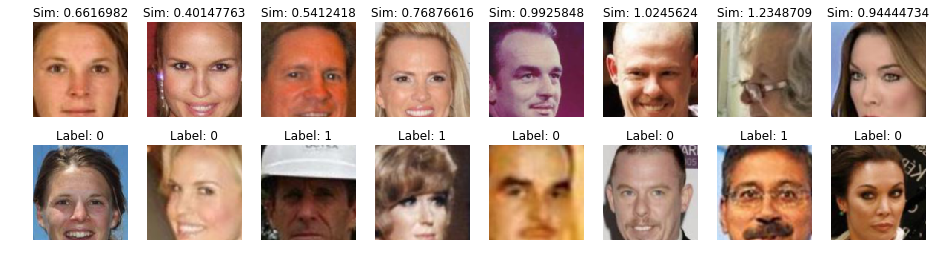

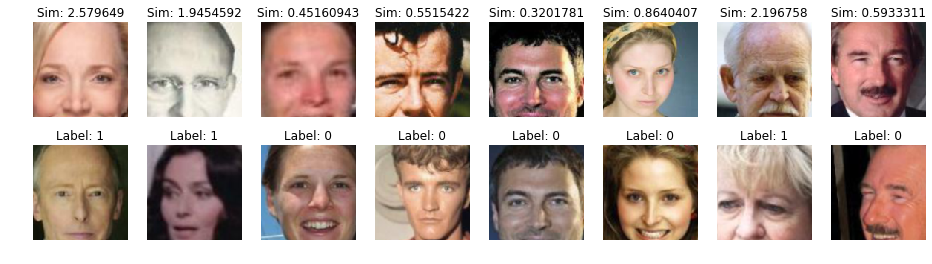

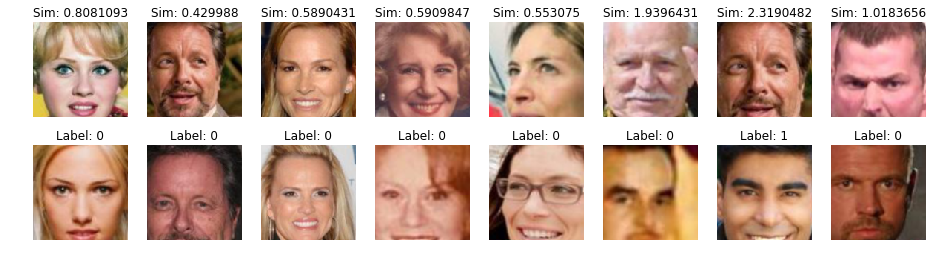

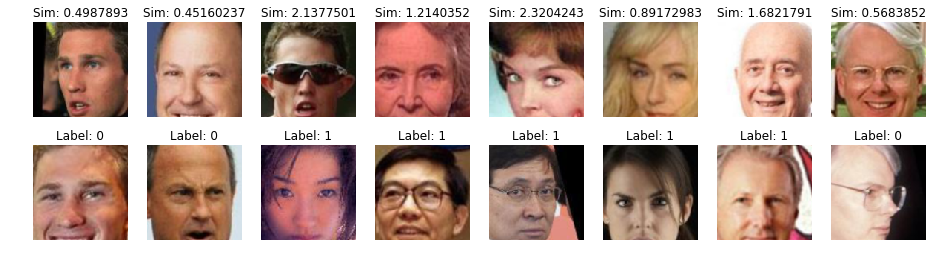

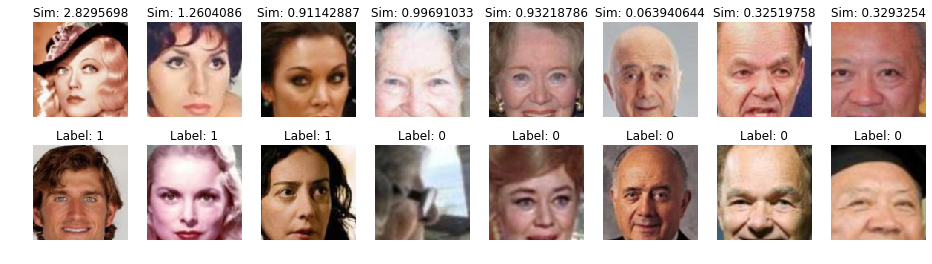

...

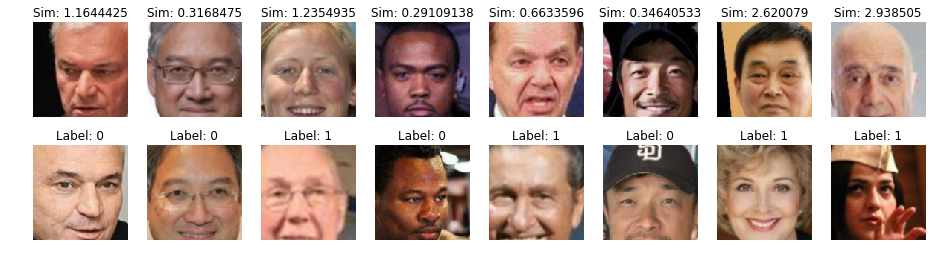

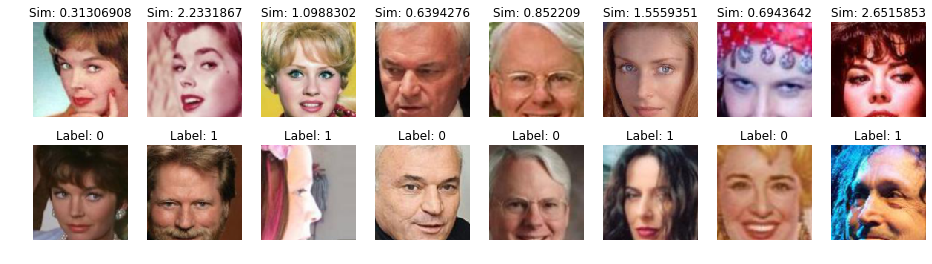

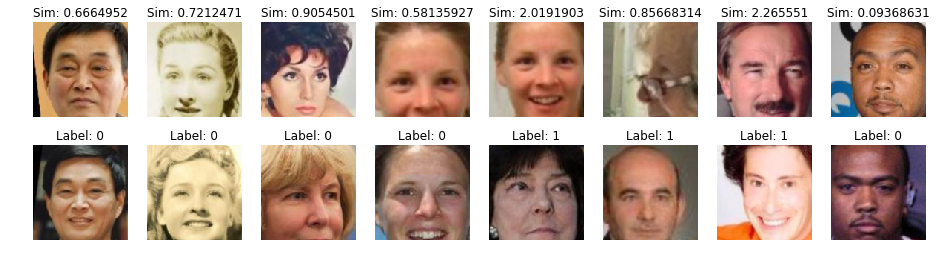

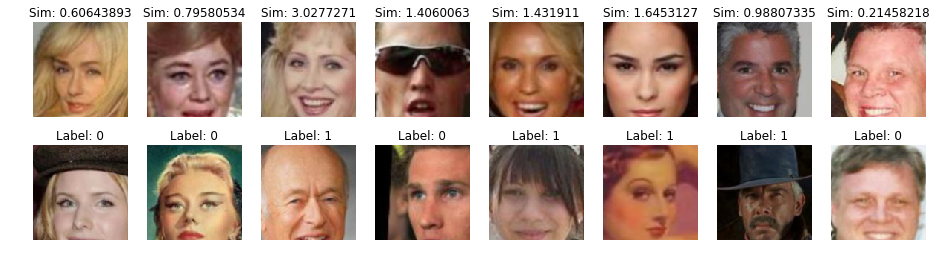

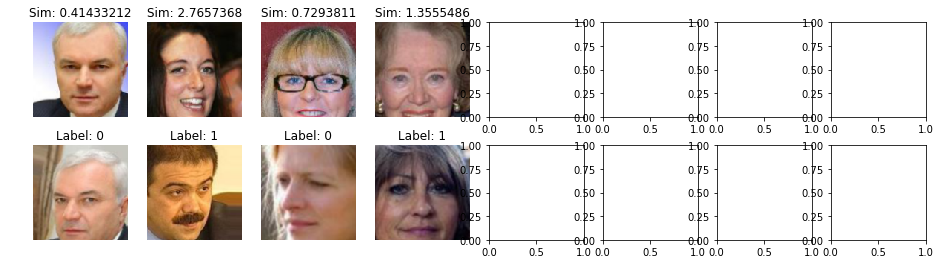

Mean similarity 0.6868994235992432 Mean Std: 0.3811371624469757.
Mean dissimilarity 1.7900891304016113 Mean Std: 0.7651093602180481.


In [11]:
mean_similarity = []
mean_dissimilarity = []

for (batch, (Xi, Xj, label)) in enumerate(test_dataset):

    with tf.contrib.summary.record_summaries_every_n_global_steps(100):

        GX1 = model(Xi, training=False)
        GX2 = model(Xj, training=False)
        _, Dw = contrastive_loss(GX1, GX2, label, margin=2.)

        f, axarr = plt.subplots(2, 8, figsize=(16,4))
        f.subplots_adjust(hspace=0.3)

        for i in range(label.shape[0]):

            Si = denormalize(Xi[i]).numpy()
            Sj = denormalize(Xj[i]).numpy()

            if label[i].numpy() == 0:
                mean_similarity.append(Dw[i])
            else:
                mean_dissimilarity.append(Dw[i])

            axarr[0, i].set_title('Sim: ' + str(Dw[i].numpy()))
            axarr[0,i].imshow(np.squeeze(Si))
            axarr[0,i].set_axis_off()

            axarr[1,i].set_title("Label: " + str(label[i].numpy()))
            axarr[1,i].imshow(np.squeeze(Sj))
            axarr[1,i].set_axis_off()

        plt.show()

mean_std_similarity_np = np.std(mean_similarity)
mean_std_dissimilarity_np = np.std(mean_dissimilarity)
mean_similarity_np = np.mean(mean_similarity)
mean_dissimilarity_np = np.mean(mean_dissimilarity)

print("Mean similarity {0} Mean Std: {1}.".format(mean_similarity_np, mean_std_similarity_np))
print("Mean dissimilarity {0} Mean Std: {1}.".format(mean_dissimilarity_np, mean_std_dissimilarity_np))